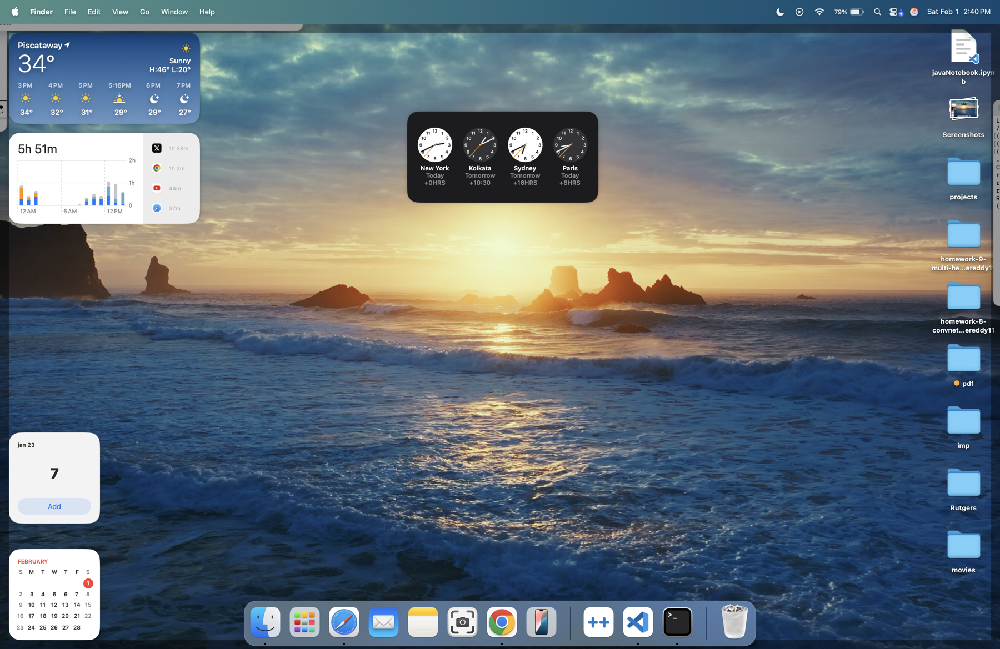

In [17]:
from io import BytesIO
from PIL import Image as PILImage
from IPython.display import display

img = PILImage.open('/Users/layakishorereddy/Desktop/projects/computer_agent/Screenshot 2025-02-01 at 2.40.37 PM.png')

width, height = img.size
new_width = int(width * 0.5)
new_height = int(height * 0.5)
small_img = img.resize((new_width, new_height))

display(small_img)


In [14]:
import base64
from io import BytesIO
buffered = BytesIO()
img.save(buffered, format="PNG")
img_bytes = buffered.getvalue()

base64_screenshot = base64.b64encode(img_bytes).decode("utf-8")

In [19]:
from PIL import Image as PILImage
from io import BytesIO
import base64

# Open the image
img = PILImage.open('/Users/layakishorereddy/Desktop/projects/computer_agent/Screenshot 2025-02-01 at 2.40.37 PM.png')

# Save the image to a BytesIO object
buffered = BytesIO()
img.save(buffered, format="PNG")
img_bytes = buffered.getvalue()

# Encode the image bytes to a base64 string
base64_screenshot = base64.b64encode(img_bytes).decode("utf-8")

# Print the base64 string (optional)
print(base64_screenshot)

iVBORw0KGgoAAAANSUhEUgAADhAAAAkiCAYAAACRrzcSAAAMSmlDQ1BJQ0MgUHJvZmlsZQAAeJyVVwdYU8kWnltSIQQIREBK6E0QkRJASggtgPQiiEpIAoQSY0JQsaOLCq5dRLCiqyCKHRCxYVcWxe5aFgsqK+tiwa68CQF02Ve+d75v7v3vP2f+OefcuWUAoLfzpdIcVBOAXEmeLCbYnzUuKZlF6gQIoAEKMAVafIFcyomKCgfQBs5/t3c3oTe0aw5KrX/2/1fTEorkAgCQKIjThHJBLsQHAcCbBFJZHgBEKeTNp+ZJlXg1xDoyGCDEVUqcocJNSpymwlf6fOJiuBA/AYCszufLMgDQ6IY8K1+QAXXoMFvgJBGKJRD7QeyTmztZCPFciG2gD5yTrtRnp/2gk/E3zbRBTT4/YxCrcukzcoBYLs3hT/8/y/G/LTdHMTCHNWzqmbKQGGXOsG5PsieHKbE6xB8kaRGREGsDgOJiYZ+/EjMzFSHxKn/URiDnwpoBJsRj5DmxvH4+RsgPCIPYEOJ0SU5EeL9PYbo4SOkD64eWifN4cRDrQVwlkgfG9vuckE2OGZj3ZrqMy+nnn/NlfTEo9b8psuM5Kn1MO1PE69fHHAsy4xIhpkIckC9OiIBYA+IIeXZsWL9PSkEmN2LAR6aIUeZiAbFMJAn2V+ljpemyoJh+/5258oHcsROZYl5EP76alxkXoqoV9kTA74sf5oJ1iySc+AEdkXxc+EAuQlFAoCp3nCySxMeqeFxPmucfoxqL20lzovr9cX9RTrCSN4M4Tp4fOzA2Pw8uTpU+XiTNi4pTxYmXZ/FDo1Tx4HtBOOCCAMACCtjSwGSQBcStXfVd8ErVEwT4QAYygAg49DMDIxL7eiTwGAsKwJ8QiYB8cJx/X68I5EP+6xBWyYkHOdXRAaT39ylVssFTiHNBGMiB14o+JclgBAngCWTE/4iID5sA5pADm7L/3/MD7HeGA5nwfkYxMCOLPuBJ

In [22]:
# Print the first 100 characters of the base64 string
print(base64_screenshot[0:100])

iVBORw0KGgoAAAANSUhEUgAADhAAAAkiCAYAAACRrzcSAAAMSmlDQ1BJQ0MgUHJvZmlsZQAAeJyVVwdYU8kWnltSIQQIREBK6E0Q


In [28]:
import os
from openai import OpenAI, OpenAIError

# Set the environment variable
os.environ["GROQ_API_KEY"] = ""

try:
    # Initialize the OpenAI client
    client = OpenAI(
        base_url="https://api.groq.com/openai/v1",
        api_key=os.environ.get("GROQ_API_KEY")
    )

    tools = [{
        "type": "function",
        "function": {
            "name": "click_mouse",
            "description": "Click on an item on the screen.",
            "parameters": {
                "type": "object",
                "properties": {
                    "query": {
                        "type": "string",
                        "description": "A description of what you want to click on"
                    }
                },
                "required": [
                    "query"
                ],
                "additionalProperties": False
            },
            "strict": True
        }
    }]

    import base64
    from PIL import Image as PILImage
    from io import BytesIO

    # Open the image
    img = PILImage.open('/Users/layakishorereddy/Desktop/projects/computer_agent/Screenshot 2025-02-01 at 2.40.37 PM.png')

    # Save the image to a BytesIO object
    buffered = BytesIO()
    img.save(buffered, format="PNG")
    img_bytes = buffered.getvalue()

    # Encode the image bytes to a base64 string
    base64_screenshot = base64.b64encode(img_bytes).decode("utf-8")

    completion = client.chat.completions.create(
        model="llama-3.2-90b-vision-preview",
        messages=[
            {"role": "user", "content": [
                {"type":"image_url", "image_url":{"url": f"data:image/jpeg;base64,{base64_screenshot}"}},
                {"type":"text", "text":"What are the contents in the image"},
                # {"type":"text", "text":"The objective is: Check the weather using the web browser?"},
            ]}
        ],
        #tools=tools
    )

    print(completion.choices[0].message.content)
    # print(completion.choices[0].message.tool_calls)

except OpenAIError as e:
    print(f"OpenAI API error: {e}")
except Exception as e:
    print(f"An error occurred: {e}")

OpenAI API error: Connection error.


In [10]:
print(base64_screenshot)

iVBORw0KGgoAAAANSUhEUgAADhAAAAkiCAYAAACRrzcSAAAMSmlDQ1BJQ0MgUHJvZmlsZQAAeJyVVwdYU8kWnltSIQQIREBK6E0QkRJASggtgPQiiEpIAoQSY0JQsaOLCq5dRLCiqyCKHRCxYVcWxe5aFgsqK+tiwa68CQF02Ve+d75v7v3vP2f+OefcuWUAoLfzpdIcVBOAXEmeLCbYnzUuKZlF6gQIoAEKMAVafIFcyomKCgfQBs5/t3c3oTe0aw5KrX/2/1fTEorkAgCQKIjThHJBLsQHAcCbBFJZHgBEKeTNp+ZJlXg1xDoyGCDEVUqcocJNSpymwlf6fOJiuBA/AYCszufLMgDQ6IY8K1+QAXXoMFvgJBGKJRD7QeyTmztZCPFciG2gD5yTrtRnp/2gk/E3zbRBTT4/YxCrcukzcoBYLs3hT/8/y/G/LTdHMTCHNWzqmbKQGGXOsG5PsieHKbE6xB8kaRGREGsDgOJiYZ+/EjMzFSHxKn/URiDnwpoBJsRj5DmxvH4+RsgPCIPYEOJ0SU5EeL9PYbo4SOkD64eWifN4cRDrQVwlkgfG9vuckE2OGZj3ZrqMy+nnn/NlfTEo9b8psuM5Kn1MO1PE69fHHAsy4xIhpkIckC9OiIBYA+IIeXZsWL9PSkEmN2LAR6aIUeZiAbFMJAn2V+ljpemyoJh+/5258oHcsROZYl5EP76alxkXoqoV9kTA74sf5oJ1iySc+AEdkXxc+EAuQlFAoCp3nCySxMeqeFxPmucfoxqL20lzovr9cX9RTrCSN4M4Tp4fOzA2Pw8uTpU+XiTNi4pTxYmXZ/FDo1Tx4HtBOOCCAMACCtjSwGSQBcStXfVd8ErVEwT4QAYygAg49DMDIxL7eiTwGAsKwJ8QiYB8cJx/X68I5EP+6xBWyYkHOdXRAaT39ylVssFTiHNBGMiB14o+JclgBAngCWTE/4iID5sA5pADm7L/3/MD7HeGA5nwfkYxMCOLPuBJ

In [15]:
base64_screenshot

'iVBORw0KGgoAAAANSUhEUgAADhAAAAkiCAYAAACRrzcSAAAMSmlDQ1BJQ0MgUHJvZmlsZQAAeJyVVwdYU8kWnltSIQQIREBK6E0QkRJASggtgPQiiEpIAoQSY0JQsaOLCq5dRLCiqyCKHRCxYVcWxe5aFgsqK+tiwa68CQF02Ve+d75v7v3vP2f+OefcuWUAoLfzpdIcVBOAXEmeLCbYnzUuKZlF6gQIoAEKMAVafIFcyomKCgfQBs5/t3c3oTe0aw5KrX/2/1fTEorkAgCQKIjThHJBLsQHAcCbBFJZHgBEKeTNp+ZJlXg1xDoyGCDEVUqcocJNSpymwlf6fOJiuBA/AYCszufLMgDQ6IY8K1+QAXXoMFvgJBGKJRD7QeyTmztZCPFciG2gD5yTrtRnp/2gk/E3zbRBTT4/YxCrcukzcoBYLs3hT/8/y/G/LTdHMTCHNWzqmbKQGGXOsG5PsieHKbE6xB8kaRGREGsDgOJiYZ+/EjMzFSHxKn/URiDnwpoBJsRj5DmxvH4+RsgPCIPYEOJ0SU5EeL9PYbo4SOkD64eWifN4cRDrQVwlkgfG9vuckE2OGZj3ZrqMy+nnn/NlfTEo9b8psuM5Kn1MO1PE69fHHAsy4xIhpkIckC9OiIBYA+IIeXZsWL9PSkEmN2LAR6aIUeZiAbFMJAn2V+ljpemyoJh+/5258oHcsROZYl5EP76alxkXoqoV9kTA74sf5oJ1iySc+AEdkXxc+EAuQlFAoCp3nCySxMeqeFxPmucfoxqL20lzovr9cX9RTrCSN4M4Tp4fOzA2Pw8uTpU+XiTNi4pTxYmXZ/FDo1Tx4HtBOOCCAMACCtjSwGSQBcStXfVd8ErVEwT4QAYygAg49DMDIxL7eiTwGAsKwJ8QiYB8cJx/X68I5EP+6xBWyYkHOdXRAaT39ylVssFTiHNBGMiB14o+JclgBAngCWTE/4iID5sA5pADm7L/3/MD7HeGA5nwfkYxMCOLPuB